# Diamond Price Analysis using Python

<img src="https://sneg.top/uploads/posts/2023-03/thumbs/1678493049_sneg-top-p-oboi-brilliant-na-chernom-fone-vkontakte-23.png" />

## Introduction
A diamond is one of the most expensive stones. The price of diamonds varies irrespective of size due to various factors. This notebook demonstrates how to analyze and predict the price of diamonds using Python.

## Dataset
We will use a dataset containing diamond prices based on their features, which can be downloaded from Kaggle. The relevant features include:
- Carat
- Cut
- Color
- Clarity
- Depth
- Table
- Price
- Size

## Libraries

In [4]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go

## Load Data

In [9]:
data = pd.read_csv("diamonds.csv")
data.head()

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


## EDA

In [12]:
data.tail()

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
53935,53936,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,53937,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,53938,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,53939,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74
53939,53940,0.75,Ideal,D,SI2,62.2,55.0,2757,5.83,5.87,3.64


In [16]:
data.shape

(53940, 11)

In [18]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  53940 non-null  int64  
 1   carat       53940 non-null  float64
 2   cut         53940 non-null  object 
 3   color       53940 non-null  object 
 4   clarity     53940 non-null  object 
 5   depth       53940 non-null  float64
 6   table       53940 non-null  float64
 7   price       53940 non-null  int64  
 8   x           53940 non-null  float64
 9   y           53940 non-null  float64
 10  z           53940 non-null  float64
dtypes: float64(6), int64(2), object(3)
memory usage: 4.5+ MB


## Data Analysis

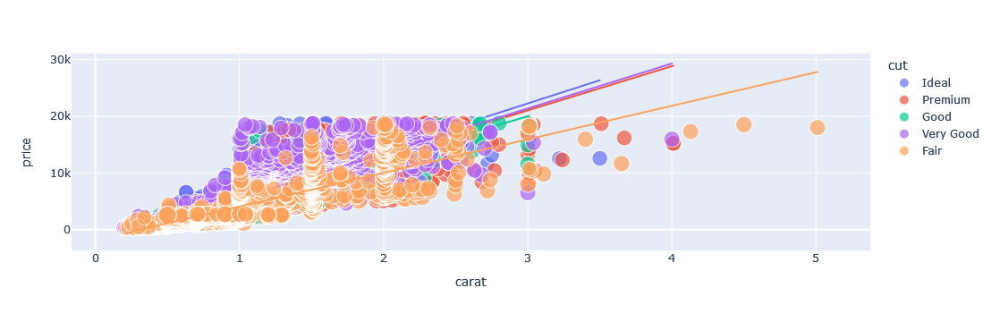

In [21]:
data = data.drop("Unnamed: 0", axis=1)
figure = px.scatter(data_frame=data, x="carat", y="price", size="depth", color="cut", trendline="ols")
figure.show()

In [23]:
data["size"] = data["x"] * data["y"] * data["z"]
data.head()

,carat,cut,color,clarity,depth,table,price,x,y,z,size
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43,38.202030
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31,34.505856
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31,38.076885
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63,46.724580
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75,51.917250


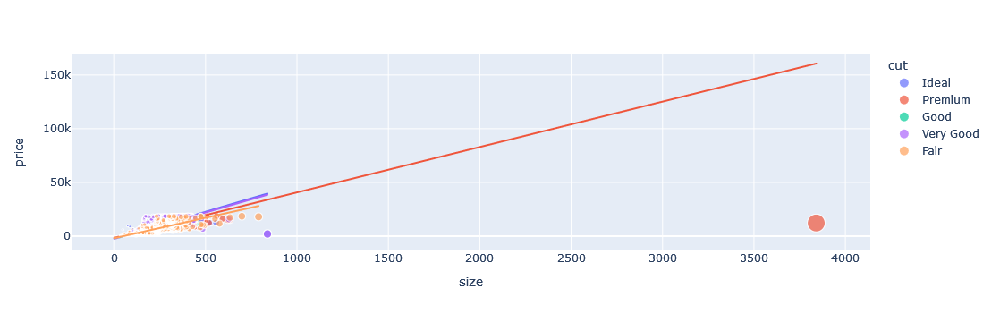

In [25]:
figure = px.scatter(data_frame=data, x="size", y="price", size="size", color="cut", trendline="ols")
figure.show()

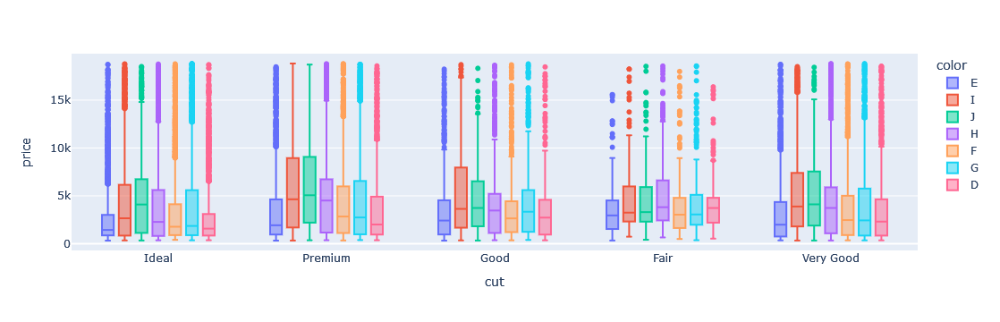

In [27]:
fig = px.box(data, x="cut", y="price", color="color")
fig.show()

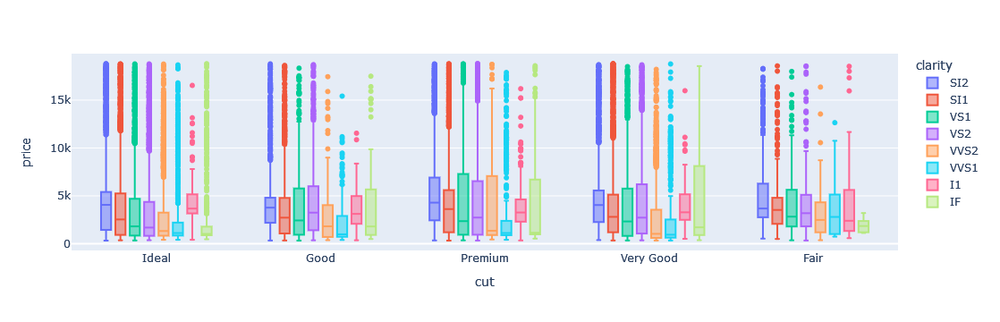

In [29]:
fig = px.box(data, x="cut", y="price", color="clarity")
fig.show()

## Correlation Analysis

In [42]:
data["cut"].unique()

array([3, 4, 1, 2, 0], dtype=int64)

In [38]:
# Mapping
mapping = {
    'Fair': 0,
    'Good': 1,
    'Very Good': 2,
    'Ideal': 3,
    'Premium': 4
}

data['cut'] = data['cut'].map(mapping)


In [44]:
data["color"].unique()

array(['E', 'I', 'J', 'H', 'F', 'G', 'D'], dtype=object)

In [48]:
# Mapping
mapping = {
    'D': 0,
    'E': 1,
    'I': 2,
    'J': 3,
    'H': 4,
    'F': 5,
    'G': 6
}

data['color'] = data['color'].map(mapping)

In [58]:
data = data.drop(columns=["clarity"])

In [60]:
correlation = data.corr()
correlation["price"].sort_values(ascending=False)

price    1.000000
carat    0.921591
size     0.902385
x        0.884435
y        0.865421
z        0.861249
table    0.127134
color    0.062450
cut      0.028843
depth   -0.010647
Name: price, dtype: float64

## Diamond Price Prediction

In [67]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

In [69]:
x = np.array(data[["carat", "cut", "size"]])
y = np.array(data[["price"]])

xtrain, xtest, ytrain, ytest = train_test_split(x, y, test_size=0.10, random_state=42)

In [71]:
model = RandomForestRegressor()
model.fit(xtrain, ytrain)

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



RandomForestRegressor()

In [73]:
a = float(input("Carat Size: "))
b = int(input("Cut Type (Ideal: 3, Premium: 4, Good: 1, Very Good: 2, Fair: 0): "))
c = float(input("Size: "))
features = np.array([[a, b, c]])
print("Predicted Diamond's Price = ", model.predict(features))

Carat Size:  5
Cut Type (Ideal: 3, Premium: 4, Good: 1, Very Good: 2, Fair: 0):  2
Size:  1


Predicted Diamond's Price =  [16365.248]


## Deep Learning

In [77]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.preprocessing import StandardScaler

In [79]:
scaler = StandardScaler()
x_scaled = scaler.fit_transform(x)

xtrain_dl, xtest_dl, ytrain_dl, ytest_dl = train_test_split(x_scaled, y, test_size=0.10, random_state=42)

In [81]:
model_dl = keras.Sequential([
    layers.Dense(128, activation='relu', input_shape=(xtrain_dl.shape[1],)),
    layers.Dense(64, activation='relu'),
    layers.Dense(32, activation='relu'),
    layers.Dense(16, activation='relu'),
    layers.Dense(8, activation='relu'),
    layers.Dense(1)
])

model_dl.compile(optimizer='adam', loss='mse')

C:\ProgramData\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



In [83]:
model_dl.fit(xtrain_dl, ytrain_dl, epochs=50, validation_split=0.2)

Epoch 1/50
1214/1214 ━━━━━━━━━━━━━━━━━━━━ 2s 845us/step - loss: 11779340.0000 - val_loss: 2094860.8750
Epoch 2/50
1214/1214 ━━━━━━━━━━━━━━━━━━━━ 1s 787us/step - loss: 2283332.7500 - val_loss: 2046235.6250
Epoch 3/50
1214/1214 ━━━━━━━━━━━━━━━━━━━━ 1s 712us/step - loss: 2123879.0000 - val_loss: 2056800.1250
Epoch 4/50
1214/1214 ━━━━━━━━━━━━━━━━━━━━ 1s 695us/step - loss: 2304939.5000 - val_loss: 2019308.7500
Epoch 5/50
1214/1214 ━━━━━━━━━━━━━━━━━━━━ 1s 686us/step - loss: 2077644.8750 - val_loss: 2005631.8750
Epoch 6/50
1214/1214 ━━━━━━━━━━━━━━━━━━━━ 1s 750us/step - loss: 2057378.1250 - val_loss: 2007538.3750
Epoch 7/50
1214/1214 ━━━━━━━━━━━━━━━━━━━━ 1s 735us/step - loss: 2059754.3750 - val_loss: 1999082.7500
Epoch 8/50
1214/1214 ━━━━━━━━━━━━━━━━━━━━ 1s 726us/step - loss: 2063418.3750 - val_loss: 1981407.5000
Epoch 9/50
1214/1214 ━━━━━━━━━━━━━━━━━━━━ 1s 705us/step - loss: 2064576.3750 - val_loss: 2013396.8750
Epoch 10/50
1214/1214 ━━━━━━━━━━━━━━━━━━━━ 1s 744us/step - loss: 2047700.3750 - v

In [85]:
predictions = model_dl.predict(xtest_dl)
predictions

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 862us/step


array([[ 456.7483 ],
       [1853.624  ],
       [1028.7114 ],
       ...,
       [1612.7301 ],
       [ 713.93494],
       [ 715.5492 ]], dtype=float32)